<a href="https://colab.research.google.com/github/bernhardtandy/ProjectsMLAI/blob/main/HW5_AndyBernhardt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Projects in Machine Learning and AI Homework 5**
## *CNNs for Pokémon Classification and VAEs/GANs for Pokémon Generation*
##### **Andy Bernhardt**
##### **bernha@rpi.edu**

---
## **Task 1: CNNs for Pokémon Classification**

In this project, we will use a dataset of images of 150 of the original Pokémon, and apply a variety of Convolutional Neural Network (CNN) models to solve the task of Pokémon Classification. As the task is an image classification task, convolutional neural networks are an appropriate architecture, as convolutional layers extract features from regions of images.


---
### **Part 0: Dataset, Exploratory Data Analysis and Preprocessing**

In this section, we will do the following:
- Load the required libraries for the project and use GPU
- Load and describe the dataset
- Perform exploratory data analysis on the dataset
- Split the dataset into train, validation, and testing sets and preprocess


### Setup

In [ ]:
# Import required libraries for project
import math
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import Normalizer, MinMaxScaler
from sklearn.utils import shuffle

import tensorflow as tf
from keras.utils.vis_utils import plot_model
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix, classification_report

In [ ]:
# Check for GPU: Make sure the the runtime has a GPU hardware accelerator selected
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
    raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


### Load dataset from Kaggle

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Load dataset from Kaggle
!pip install kaggle
!mkdir ~/.kaggle
!cp /content/drive/MyDrive/ProjectsMLAI/HW5/kaggle.json ~/.kaggle/
!kaggle datasets download lantian773030/pokemonclassification
!unzip /content/pokemonclassification.zip -d/content/dataset

### Dataset description

The 7,000 Labeled Pokemon dataset (from Kaggle) contains 150 folders with 25-50 images each, with each folder containing images of a different Pokémon. These images generally have the Pokémon in the center, but are from different domains and have relatively low resolution. 

In this project, we load in the images as 128 x 128 x 3 matrices (RGB), split the dataset into training, validation, and testing sets, and train and evaluate a variety of CNN models for the task of Pokémon classification (150 classes). These include a basic CNN on the original data, a ResNet50-based model that is fine-tuned, and again the basic CNN but trained using data augmentation.
  
Link to dataset: https://www.kaggle.com/datasets/lantian773030/pokemonclassification

### Initial preprocessing

In [ ]:
# Define the directory containing the dataset
import os
directory = '/content/dataset/PokemonData'

In [ ]:
# Get all the label names from the directories
label_names = []
label_names = [str(dir) for dir in os.listdir(directory)]
len(label_names)
# There are 150 different Pokémon in the dataset

150

In [ ]:
# Load the dataset with one-hot encoded labels (each label is a 150-dimensional vector),
# and image size of 128 x 128 x 3 (RGB channels)
dataset = tf.keras.utils.image_dataset_from_directory(directory,
    labels="inferred",
    label_mode="categorical",
    class_names=label_names,
    color_mode="rgb",
    batch_size=None,
    image_size=(128, 128),
    shuffle=True,
    seed=42,
    validation_split=None)
# In total, there are 6,820 images and 150 classes, so on average, there are 45.47 images per class (relatively small dataset).

Found 6820 files belonging to 150 classes.


In [ ]:
# Get dataset into numpy arrays
X = []
Y = []
for x, y in dataset:
  X.append(x)
  Y.append(y)
del dataset
X = np.asarray(X).astype("int32")
Y = np.asarray(Y).astype("int32")

In [ ]:
# Check the shapes of the image data and labels
print(X.shape, Y.shape)
# We have 6,820 128 x 128 x 3 images and 6,820 corresponding 150-dimensional labels

(6820, 128, 128, 3) (6820, 150)


In [ ]:
# Split dataframe into training (80%), validation (10%), and testing (10%) sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.10, random_state=42)
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=1./9., random_state=42)
del X
del Y
X_train.shape, Y_train.shape, X_val.shape, Y_val.shape, X_test.shape, Y_test.shape
# Show the sizes of the training, validation, and testing sets

((5456, 128, 128, 3),
 (5456, 150),
 (682, 128, 128, 3),
 (682, 150),
 (682, 128, 128, 3),
 (682, 150))

### Exploratory Data Analysis

In [ ]:
# Create a dataframe containing class names and counts in training data
images_per_class = np.sum(Y_train, axis=0)
data = {'Class Names': label_names,
        'Count': images_per_class}
df = pd.DataFrame(data)
df

In [ ]:
# Describe class label distribution in training data
df.describe()
# The number of images per label in the training data rangees from 19 to 55
# with mean 36.3733. We have a relatively small number of examples for each class.

,Count
count,150.000000
mean,36.373333
std,5.787683
min,19.000000
25%,33.000000
50%,36.000000
75%,40.000000
max,55.000000


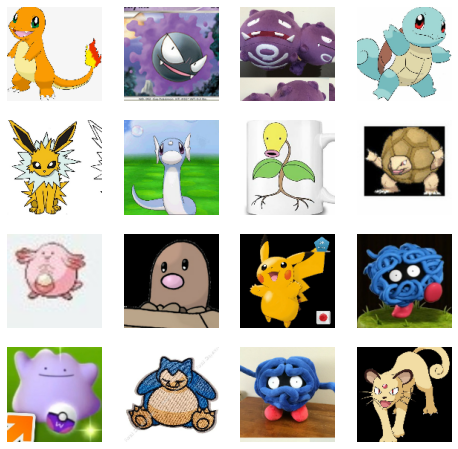

In [ ]:
# Plot 16 images from the training dataset
fig = plt.figure(figsize=(8, 8))

for i in range(16):
  plt.subplot(4, 4, i + 1)
  plt.imshow(X_train[i])
  plt.axis('off')

plt.show()
# We see that the Pokémon are generally centered and the entire Pokémon is in the image
# However, the images have different backgrounds (some white, some black, some other), 
# some images have parts of other Pokémon in the image, and the images seem to come from 
# different domains. For example, X_train[6] (Bellsprout) seems to be on a mug. 
# This could lead to some challenges in training

In [ ]:
# Ensure that the labels are aligned with the images:
labels = list(np.argmax(Y_train[0:16], axis=1))
[label_names[l] for l in labels]
# These are the correct labels for each Pokémon

['Charmander',
 'Gastly',
 'Weezing',
 'Squirtle',
 'Jolteon',
 'Dratini',
 'Bellsprout',
 'Golem',
 'Chansey',
 'Diglett',
 'Pikachu',
 'Tangela',
 'Ditto',
 'Snorlax',
 'Tangela',
 'Persian']

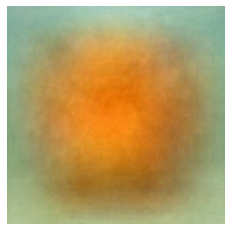

In [ ]:
# Compute and show the mean Pokémon image from the training data
mean_image = np.mean(X_train, axis = 0)
image_min = np.min(mean_image)
image_max = np.max(mean_image)
mean_image = (mean_image - image_min) / (image_max - image_min)
plt.imshow(mean_image)
plt.axis('off')
plt.show()
# The mean Pokémon image is orange in the center and green in the background

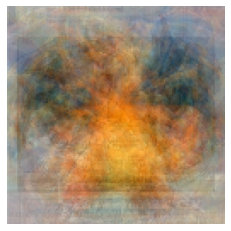

In [ ]:
# Compute and show the mean Charizard image from the training data
indices_charizard = [i for i in range(len(Y_train)) if Y_train[i][label_names.index("Charizard")] == 1]
mean_image_charizard = np.mean(X_train[indices_charizard], axis = 0)
image_min = np.min(mean_image_charizard)
image_max = np.max(mean_image_charizard)
mean_image_charizard = (mean_image_charizard - image_min) / (image_max - image_min)
plt.imshow(mean_image_charizard)
plt.axis('off')
plt.show()

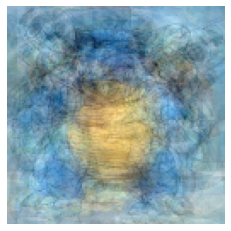

In [ ]:
# Compute and show the mean Blastoise image from the training data
indices_blastoise = [i for i in range(len(Y_train)) if Y_train[i][label_names.index("Blastoise")] == 1]
mean_image_blastoise = np.mean(X_train[indices_blastoise], axis = 0)
image_min = np.min(mean_image_blastoise)
image_max = np.max(mean_image_blastoise)
mean_image_blastoise = (mean_image_blastoise - image_min) / (image_max - image_min)
plt.imshow(mean_image_blastoise)
plt.axis('off')
plt.show()

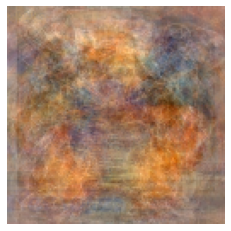

In [ ]:
# Compute and show the difference between mean Charizard and mean Blastoise images
difference = mean_image_charizard - mean_image_blastoise
image_min = np.min(difference)
image_max = np.max(difference)
difference = (difference - image_min) / (image_max - image_min)
plt.imshow(difference)
plt.axis('off')
plt.show()
# We see that for these two Pokémon, a major difference is in the color
# Charizard is mainly orange, and Blastoise is mainly blue

### Data preprocessing

In [ ]:
# We normalize the data by subtracting the mean of the training data for each 
# pixel and dividing by the standard deviation
X_train_mean = np.mean(X_train, axis=0)
X_train_stdev = np.std(X_train, axis=0)
X_train = (X_train - X_train_mean) / X_train_stdev
X_val = (X_val - X_train_mean) / X_train_stdev
X_test = (X_test - X_train_mean) / X_train_stdev

---
### **Part 1: CNN for Pokémon Classification**

In this section, we define functions for creating models based on CNN and ResNet50 for transfer learning architectures, and also functions for training, evaluating, and plotting the loss history. We train a small CNN model on the training set and describe the structure of this CNN, and finally evaluate the performance of this CNN on the validation and testing sets with respect to a multi-class classification metric. Since the classes are somewhat imbalanced, and false positives and false negatives are equally detrimental to the performance, we will use macro-average F1-score as our main evaluation metric. This metric weights all classes' F1-scores evenly, as it is the arithmetic mean of the per-class F1-scores, which are each the harmonic mean of precision and recall within their own classes. As a result, since we care about each class equally regardless of the sizes in the training data (we don't care about certain Pokémon more than others), we use macro-average F1-score.

In [ ]:
# This function creates an CNN model

# The architecture is as follows:
# Input Layer: 128 x 128 x 3
# Convolutional Layer: 16 filters, 11 x 11, with ReLU activation
# Max Pooling Layer: 3 x 3 max pooling
# Convolutional Layer: 32 filters, 5 x 5, with ReLU activation
# Max Pooling Layer: 3 x 3 max pooling
# Batch Normalization Layer: for helping training stability and preventing exploding gradients
# Dropout Layer: 0.5: for regularization
# Linear Layer: 128 nodes, with ReLU activation
# Dropout Layer: 0.5: for regularization
# Output Layer: 150 nodes (one for each class), with softmax activation

# We designed this architecture as a smaller CNN inspired by AlexNet,
# with convolutional layers having increasing number of filters but smaller filters,
# and using batch normalization after the convolutional layers and a number of
# dropout layers to improve the stability of training and regularize.
# Compared to ResNet50, which we use in the next part for transfer learning,
# this architecture is much smaller. However, even with tuning of the layers and
# dropout/batch normalization throughout the network, we still overfit. 
def createCNN(name):

    input = tf.keras.layers.Input(shape=(128, 128, 3), name='input', dtype='float64')

    conv_1 = tf.keras.layers.Conv2D(16, (11, 11), activation='relu', input_shape=(128, 128, 3))(input)
    mp_1 = tf.keras.layers.MaxPooling2D((3, 3))(conv_1)
    
    conv_2 = tf.keras.layers.Conv2D(32, (5, 5), activation='relu')(mp_1)
    mp_2 = tf.keras.layers.MaxPooling2D((3, 3))(conv_2)
    bn_2 = tf.keras.layers.BatchNormalization()(mp_2)
    
    d_2 = tf.keras.layers.Dropout(0.5)(bn_2)
    f = tf.keras.layers.Flatten()(d_2)
    
    linear_1 = tf.keras.layers.Dense(128, activation='relu')(f)
    d_3 = tf.keras.layers.Dropout(0.5)(linear_1)
    output = tf.keras.layers.Dense(150, activation='softmax')(d_3)

    model = tf.keras.Model(name=name, inputs=input, outputs=output)

    return model

In [ ]:
# This function creates an ResNet50 model for transfer learning for the 150 Pokémon classification task

# The architecture is as follows:
# Input Layer: 128 x 128 x 3
# ResNet50 Layer: uses pretrained ImageNet weights and mean pooling at the end 
# Batch Normalization Layer: for helping training stability and preventing exploding gradients
# Dropout Layer: 0.5: for regularization
# Linear Layer: 128 nodes, with ReLU activation
# Dropout Layer: 0.5: for regularization
# Output Layer: 150 nodes (one for each class), with softmax activation

# We choose to use the same dense and dropout layer structure after the convolutional layers
# as in the CNN model defined above. Additionally, we allow the layers in ResNet50
# to be trained rather than freezing them, but use a smaller learning rate
# (another option would have been to fine-tune for a few epochs with a larger learning rate 
# with ResNet50 parameters frozen, and then fine-tune for a few epochs with a smaller learning
# rate with ResNet50 parameters unfrozen)
def createResNet50(name):

    input = tf.keras.layers.Input(shape=(128, 128, 3), name='input', dtype='float64')

    resnet50 = tf.keras.applications.resnet50.ResNet50(include_top=False,
    weights='imagenet',
    input_shape=(128, 128, 3),
    pooling='avg',
    classes=150)
    # for layer in resnet50.layers:
    #    layer.trainable=False
    resnet_50_output = resnet50(input)
    bn_2 = tf.keras.layers.BatchNormalization()(resnet_50_output)
    d_1 = tf.keras.layers.Dropout(0.5)(bn_2)
    f = tf.keras.layers.Flatten()(d_1)
    linear_1 = tf.keras.layers.Dense(128, activation='relu')(f)
    d_2 = tf.keras.layers.Dropout(0.5)(linear_1)
    output =tf.keras.layers.Dense(150, activation='softmax')(d_2)

    model = tf.keras.Model(name=name, inputs=input, outputs=output)

    return model

In [ ]:
# This function trains a CNN on the training data (X_train, Y_train) with early stopping with 
# patience 10 on the validation data (X_val, Y_val), using batch size batch_size
# The loss function is categorical crossentropy, as this is a 150-class classification problem (single-label)
def train(model_architecture, name, X_train, Y_train, X_val, Y_val, batch_size, learning_rate):
    if (model_architecture == "CNN"):
        model = createCNN(name)
    if (model_architecture == "ResNet50"):
        model = createResNet50(name)
    es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, verbose=2, restore_best_weights=True)
    model.compile(loss='categorical_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), metrics=[tf.keras.metrics.CategoricalAccuracy()])
    history = model.fit(x=X_train, y=Y_train, epochs=1000, batch_size=batch_size, validation_data=(X_val, Y_val), 
                        callbacks=[es], verbose=2)
    return model, history

In [ ]:
# This function evaluates a model based on the data (X, y)
# We compute the accuracy, macro-average F1-score, macro-average precision, macro-average recall, and a classification report
# but note that our main evaluation metric will be macro-average F1-score
def evaluate(model, X, y, names):
    predictions = model.predict(X, batch_size=16)
    predictions = [[1 if p == np.max(prediction) else 0 for p in prediction] for prediction in predictions]
    labels = y
    acc = accuracy_score(labels, predictions)
    f1 = f1_score(labels, predictions, average='macro')
    p = precision_score(labels, predictions, average='macro')
    r = recall_score(labels, predictions, average='macro')
    cr = classification_report(labels, predictions, target_names=names)
    return acc, f1, p, r, cr

In [ ]:
# This function produces two plots from the model training history structure:
# The first shows training and validation loss vs. epoch number
# The second shows training and validation accuracy vs. epoch number
def plotHistory(history):
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.xlabel("Epoch Number")
  plt.ylabel("Categorical Cross-Entropy Loss")
  plt.title("Categorical Cross-Entropy Loss vs. Epoch Number")
  plt.legend(["Training Loss", "Validation Loss"])
  plt.grid()
  plt.show()

  plt.plot(history.history['categorical_accuracy'])
  plt.plot(history.history['val_categorical_accuracy'])
  plt.xlabel("Epoch Number")
  plt.ylabel("Accuracy")
  plt.title("Accuracy vs. Epoch Number")
  plt.legend(["Training Accuracy", "Validation Accuracy"])
  plt.grid()
  plt.show()

In [ ]:
# Train a CNN model on the training and validation data, with batch size 16
CNN, history = train("CNN", "CNN", X_train, Y_train, X_val, Y_val, 16, 5e-4)

Epoch 1/1000
341/341 - 8s - loss: 5.2130 - categorical_accuracy: 0.0269 - val_loss: 4.3691 - val_categorical_accuracy: 0.0997 - 8s/epoch - 24ms/step
Epoch 2/1000
341/341 - 2s - loss: 4.3289 - categorical_accuracy: 0.0944 - val_loss: 3.5827 - val_categorical_accuracy: 0.1935 - 2s/epoch - 6ms/step
Epoch 3/1000
341/341 - 2s - loss: 3.7531 - categorical_accuracy: 0.1657 - val_loss: 3.2347 - val_categorical_accuracy: 0.2845 - 2s/epoch - 7ms/step
Epoch 4/1000
341/341 - 2s - loss: 3.3320 - categorical_accuracy: 0.2221 - val_loss: 2.7978 - val_categorical_accuracy: 0.3666 - 2s/epoch - 7ms/step
Epoch 5/1000
341/341 - 2s - loss: 2.9273 - categorical_accuracy: 0.2889 - val_loss: 2.5107 - val_categorical_accuracy: 0.4282 - 2s/epoch - 7ms/step
Epoch 6/1000
341/341 - 2s - loss: 2.6656 - categorical_accuracy: 0.3404 - val_loss: 2.3244 - val_categorical_accuracy: 0.4589 - 2s/epoch - 7ms/step
Epoch 7/1000
341/341 - 2s - loss: 2.3962 - categorical_accuracy: 0.3955 - val_loss: 2.2390 - val_categorical_ac

In [ ]:
# Summarize the CNN model
CNN.summary()
# There are 533,878 total parameters in this model

Model: "CNN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 128, 128, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 118, 118, 16)      5824      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 39, 39, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 35, 35, 32)        12832     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 11, 11, 32)       0         
 2D)                                                             
                                                                 
 batch_normalization (BatchN  (None, 11, 11, 32)       128     

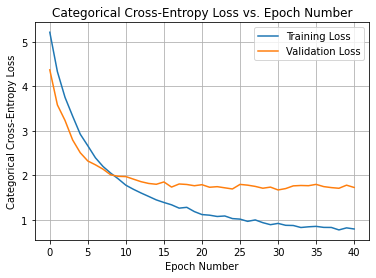

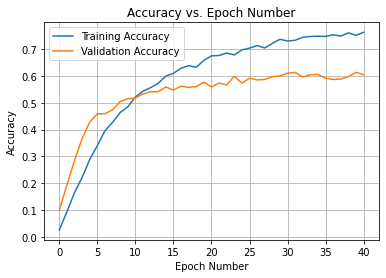

In [ ]:
# Plot the training and validation loss over the training loop
plotHistory(history)
# The model begins to overfit after approximately 20 epochs
# We have tried both smaller and larger architectures with varying amounts of pooling,
# batch normalization, and dropout and not improved these results

In [ ]:
# Show the CNN model's final performance on the training data
acc, f1, p, r, cr = evaluate(CNN, X_train, Y_train, label_names)
print(f"Accuracy: {acc}")
print(f"F1 Score: {f1}")
print(f"Precision: {p}")
print(f"Recall: {r}")
print(f"Classification Report:\n{cr}")
# The model overfits the training data, achieving a macro-average F1-score of 0.9876

341/341 [==============================] - 2s 6ms/step
Accuracy: 0.9875366568914956
F1 Score: 0.9876250180444386
Precision: 0.988431688480815
Recall: 0.9874395601869461
Classification Report:
                  precision    recall  f1-score   support

          Fearow       1.00      0.98      0.99        43
         Dugtrio       1.00      1.00      1.00        40
          Pidgey       1.00      1.00      1.00        36
         Venonat       1.00      1.00      1.00        41
         Kingler       1.00      0.95      0.97        37
        Articuno       1.00      1.00      1.00        33
          Machop       1.00      1.00      1.00        33
        Raticate       1.00      1.00      1.00        29
         Ivysaur       1.00      1.00      1.00        30
             Muk       0.92      1.00      0.96        36
         Haunter       1.00      1.00      1.00        35
          Grimer       0.97      0.94      0.95        33
          Dodrio       1.00      1.00      1.00      

In [ ]:
# Evaluate the CNN model on the validation data
acc, f1, p, r, cr = evaluate(CNN, X_val, Y_val, label_names)
print(f"Accuracy: {acc}")
print(f"F1 Score: {f1}")
print(f"Precision: {p}")
print(f"Recall: {r}")
print(f"Classification Report:\n{cr}")
# The model performs OK on the validation data, achieving a macro-average F1-score of 0.5536
# Although this shows that the model severely overfit the training data, we note that
# 0.5536 is not terrible since this is a 150-class classification task with minimal data 

43/43 [==============================] - 0s 4ms/step
Accuracy: 0.6099706744868035
F1 Score: 0.5536044293397234
Precision: 0.5872962962962963
Recall: 0.5805608465608465
Classification Report:
                  precision    recall  f1-score   support

          Fearow       0.33      0.33      0.33         3
         Dugtrio       0.75      0.43      0.55         7
          Pidgey       0.71      0.83      0.77         6
         Venonat       0.40      0.50      0.44         4
         Kingler       0.67      0.67      0.67         6
        Articuno       0.50      0.75      0.60         4
          Machop       0.50      0.75      0.60         4
        Raticate       1.00      0.29      0.44         7
         Ivysaur       0.80      0.80      0.80         5
             Muk       0.20      0.33      0.25         3
         Haunter       0.55      0.60      0.57        10
          Grimer       0.57      0.67      0.62         6
          Dodrio       0.00      0.00      0.00       

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedM

In [ ]:
# Evaluate the CNN model on the testing data
acc, f1, p, r, cr = evaluate(CNN, X_test, Y_test, label_names)
print(f"Accuracy: {acc}")
print(f"F1 Score: {f1}")
print(f"Precision: {p}")
print(f"Recall: {r}")
print(f"Classification Report:\n{cr}")
# The model performs OK on the testing data, achieving a macro-average F1-score of 0.5374
# Although this shows that the model severely overfit the training data, we note that
# 0.5374 is not terrible since this is a 150-class classification task with minimal data 

43/43 [==============================] - 0s 4ms/step
Accuracy: 0.5835777126099707
F1 Score: 0.5373621212073897
Precision: 0.5910726310726311
Recall: 0.5661863876863877
Classification Report:
                  precision    recall  f1-score   support

          Fearow       0.33      0.50      0.40         2
         Dugtrio       0.80      1.00      0.89         4
          Pidgey       0.50      0.50      0.50         6
         Venonat       0.00      0.00      0.00         2
         Kingler       0.29      0.50      0.36         4
        Articuno       0.56      0.62      0.59         8
          Machop       1.00      0.50      0.67         4
        Raticate       1.00      0.40      0.57         5
         Ivysaur       0.83      1.00      0.91         5
             Muk       0.38      1.00      0.55         3
         Haunter       0.00      0.00      0.00         3
          Grimer       0.00      0.00      0.00         5
          Dodrio       1.00      0.57      0.73       

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedM

Ultimately, we show the macro-average F1-score (as well as accuracy, which is calculated over all data and does not weight each class equally) of the small CNN model (533,878 total parameters) on the training, validation and testing sets.

| Metric | Training | Validation | Testing |
|:---:|:---:|:---:|:---:|
|**Macro-Average F1-Score**| 0.9876 | 0.5536 | 0.5374
|Accuracy| 0.9875 | 0.6100 | 0.5836

We see that this CNN model overfits the training data severely, but still achieves decent performance on the testing data for the 150-class classification task (random baseline would achieve approximately 0.0067 accuracy). Compared to other CNN architectures that we experimented with, this architecture achieves the best results on the validation data, so we keep this architecture. We note that with certain improvements in regularization, we could probably keep the training and validation learning curves closes, and overfit less.

---
### **Part 2: ResNet50 for Pokémon Classification**

In this section, we fine-tune a ResNet50-based CNN model for the task of Pokémon classification, and evaluate the performance of this CNN on the validation and testing sets. This model uses the ResNet50 model with pretrained weights from ImageNet classification, and appends a few linear and dropout layers on top for the 150-class Pokémon classification. We compare the results to the results obtained by the small CNN from Part 1. 

In [ ]:
# Fine-tune a ResNet50-based  model on the training and validation data, with batch size 16
RN50, history = train("ResNet50", "ResNet50", X_train, Y_train, X_val, Y_val, 16, 1e-4)

94765736/94765736 [==============================] - 1s 0us/step
Epoch 1/1000
341/341 - 39s - loss: 5.6924 - categorical_accuracy: 0.0310 - val_loss: 5.0074 - val_categorical_accuracy: 0.0308 - 39s/epoch - 116ms/step
Epoch 2/1000
341/341 - 26s - loss: 3.9431 - categorical_accuracy: 0.1824 - val_loss: 2.5988 - val_categorical_accuracy: 0.4707 - 26s/epoch - 77ms/step
Epoch 3/1000
341/341 - 26s - loss: 2.6273 - categorical_accuracy: 0.4052 - val_loss: 1.2861 - val_categorical_accuracy: 0.7595 - 26s/epoch - 76ms/step
Epoch 4/1000
341/341 - 26s - loss: 1.6889 - categorical_accuracy: 0.6003 - val_loss: 0.8683 - val_categorical_accuracy: 0.8314 - 26s/epoch - 78ms/step
Epoch 5/1000
341/341 - 27s - loss: 1.0939 - categorical_accuracy: 0.7306 - val_loss: 0.7143 - val_categorical_accuracy: 0.8372 - 27s/epoch - 79ms/step
Epoch 6/1000
341/341 - 26s - loss: 0.7534 - categorical_accuracy: 0.8101 - val_loss: 0.5925 - val_categorical_accuracy: 0.8607 - 26s/epoch - 78ms/step
Epoch 7/1000
341/341 - 27s -

In [ ]:
# Summarize the ResNet50-based model
RN50.summary()
# There are 23,877,526 total parameters in this model

Model: "ResNet50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 128, 128, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 2048)              23587712  
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 flatten (Flatten)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 128)               262272    
                                                          

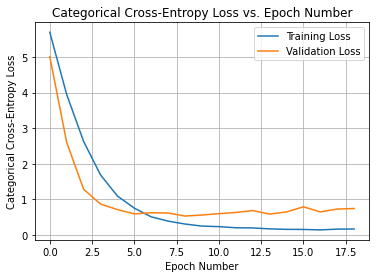

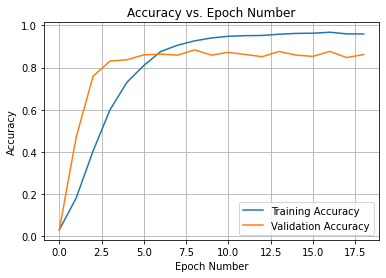

In [ ]:
# Plot the training and validation loss over the training loop
plotHistory(history)
# The loss starts high and soon becomes close to 0
# This model still overfits, but much less so than the small CNN from Part 1

In [ ]:
# Show the ResNet50-based model's final performance on the training data
acc, f1, p, r, cr = evaluate(RN50, X_train, Y_train, label_names)
print(f"Accuracy: {acc}")
print(f"F1 Score: {f1}")
print(f"Precision: {p}")
print(f"Recall: {r}")
print(f"Classification Report:\n{cr}")

341/341 [==============================] - 8s 20ms/step
Accuracy: 0.9928519061583577
F1 Score: 0.991837469197345
Precision: 0.9933207556712248
Recall: 0.9916841763426104
Classification Report:
                  precision    recall  f1-score   support

         Poliwag       1.00      1.00      1.00        37
       Hitmonlee       1.00      1.00      1.00        36
          Tauros       1.00      1.00      1.00        47
          Pidgey       1.00      1.00      1.00        36
      Victreebel       1.00      1.00      1.00        35
         Moltres       1.00      0.97      0.99        37
       Charizard       1.00      1.00      1.00        28
      Electabuzz       1.00      1.00      1.00        31
          Vulpix       1.00      1.00      1.00        41
        Nidoking       1.00      1.00      1.00        40
       Farfetchd       1.00      1.00      1.00        40
          Dodrio       1.00      1.00      1.00        30
        Kabutops       1.00      1.00      1.00     

In [ ]:
# Evaluate the ResNet50-based model on the validation data
acc, f1, p, r, cr = evaluate(RN50, X_val, Y_val, label_names)
print(f"Accuracy: {acc}")
print(f"F1 Score: {f1}")
print(f"Precision: {p}")
print(f"Recall: {r}")
print(f"Classification Report:\n{cr}")

43/43 [==============================] - 2s 22ms/step
Accuracy: 0.8841642228739003
F1 Score: 0.855972809278436
Precision: 0.871419672919673
Recall: 0.8694100529100528
Classification Report:
                  precision    recall  f1-score   support

         Poliwag       1.00      0.86      0.92         7
       Hitmonlee       1.00      0.67      0.80         3
          Tauros       1.00      0.67      0.80         3
          Pidgey       1.00      1.00      1.00         6
      Victreebel       0.80      0.80      0.80         5
         Moltres       0.33      0.50      0.40         2
       Charizard       1.00      1.00      1.00         3
      Electabuzz       0.89      1.00      0.94         8
          Vulpix       0.86      1.00      0.92         6
        Nidoking       1.00      0.80      0.89         5
       Farfetchd       1.00      1.00      1.00         2
          Dodrio       0.67      1.00      0.80         2
        Kabutops       1.00      0.88      0.93        

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedM

In [ ]:
# Evaluate the ResNet50-based model on the testing data
acc, f1, p, r, cr = evaluate(RN50, X_test, Y_test, label_names)
print(f"Accuracy: {acc}")
print(f"F1 Score: {f1}")
print(f"Precision: {p}")
print(f"Recall: {r}")
print(f"Classification Report:\n{cr}")

43/43 [==============================] - 1s 21ms/step
Accuracy: 0.8900293255131965
F1 Score: 0.8635288937641877
Precision: 0.8790952380952382
Recall: 0.8744521404521405
Classification Report:
                  precision    recall  f1-score   support

         Poliwag       1.00      1.00      1.00         7
       Hitmonlee       1.00      1.00      1.00         9
          Tauros       0.80      1.00      0.89         4
          Pidgey       0.80      0.67      0.73         6
      Victreebel       1.00      0.89      0.94         9
         Moltres       1.00      0.75      0.86         4
       Charizard       0.75      0.75      0.75         4
      Electabuzz       1.00      1.00      1.00         2
          Vulpix       1.00      1.00      1.00         3
        Nidoking       1.00      1.00      1.00         7
       Farfetchd       0.67      1.00      0.80         6
          Dodrio       1.00      0.86      0.92         7
        Kabutops       1.00      1.00      1.00      

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedM

Ultimately, we show the macro-average F1-score of both the small CNN model (533,878 total parameters) and the large ResNet50-based model (23,877,526 total parameters) on the training, validation and testing sets.

| Model | Training | Validation | Testing |
|:---:|:---:|:---:|:---:|
|Small CNN| 0.9876 | 0.5536 | 0.5374
|ResNet50-based| **0.9918** | **0.8560** | **0.8635**

We see that the ResNet50-based model, after only a few epochs, learns the new dataset pretty well, and generalizes much better than our small CNN architecture, achieving just as high training accuracy but performing much better on the validation and testing sets. The particular architectural innovations of ResNet50, including its residual blocks, and the pretrained weights, provide a strong starting point for transfer learning. Across all of the 150 Pokémon categories, the model achieves high classification performance.

---
### **Part 3: Data Augmented CNN for Pokémon Classification**

In this section, we use data augmentation to increase the diversity of the training data, and again train the small CNN model using the augmented data for the task of Pokémon classification. We compare the results to the results obtained by the small CNN from Part 1. In order to perform the data augmentation, we use the keras ImageDataGenerator and generate batches of training images at each training step.

In [ ]:
# Define a keras ImageDataGenerator with small maximum rotation angle and small maximum shift
# The data is mostly centered so we do not want to shift too much
shift = 0.2
max_angle = 15
idg = tf.keras.preprocessing.image.ImageDataGenerator(width_shift_range=shift, height_shift_range=shift, rotation_range=max_angle, fill_mode='nearest')

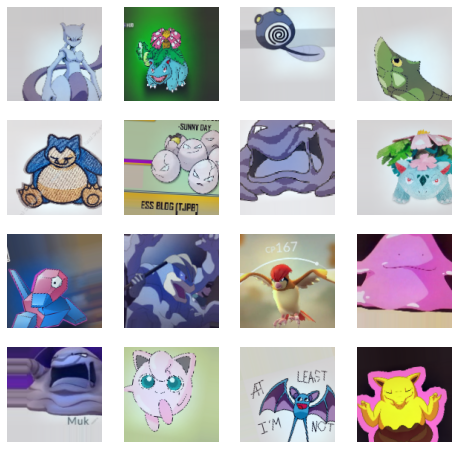

In [ ]:
# Generate a few examples of augmented images
generated_images = idg.flow(X_train, batch_size=1)

fig = plt.figure(figsize=(8, 8))

for i in range(16):
  plt.subplot(4, 4, i + 1)
  image = generated_images[i][0]
  image_min = np.min(image)
  image_max = np.max(image)
  image = (image - image_min) / (image_max - image_min)
  plt.imshow(image)
  plt.axis('off')

plt.show()

In [ ]:
# This function trains a CNN on the training data (X_train, Y_train) with early stopping with 
# patience 10 on the validation data (X_val, Y_val), using batch size batch_size
# The loss function is categorical crossentropy, as this is a 150-class classification problem (single-label)
# The data is augmented using the keras ImageDataGenerator
def train_augmented(model_architecture, name, X_train, Y_train, X_val, Y_val, batch_size, learning_rate, idg):
  model = createCNN(name)
  es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, verbose=2, restore_best_weights=True)
  model.compile(loss='categorical_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), metrics=[tf.keras.metrics.CategoricalAccuracy()])
  history = model.fit(idg.flow(X_train, Y_train, batch_size=batch_size, shuffle=True), epochs=1000, validation_data=(X_val, Y_val), 
                      callbacks=[es], verbose=2)
  return model, history

In [ ]:
# Train an augmented CNN model on the training and validation data, with batch size 16
CNN_augmented, history = train_augmented("CNN_Augmented", "CNN_Augmented", X_train, Y_train, X_val, Y_val, 16, 5e-4, idg)

Epoch 1/1000
341/341 - 23s - loss: 5.6286 - categorical_accuracy: 0.0121 - val_loss: 4.7730 - val_categorical_accuracy: 0.0381 - 23s/epoch - 67ms/step
Epoch 2/1000
341/341 - 18s - loss: 4.9587 - categorical_accuracy: 0.0288 - val_loss: 4.3890 - val_categorical_accuracy: 0.0792 - 18s/epoch - 52ms/step
Epoch 3/1000
341/341 - 18s - loss: 4.6889 - categorical_accuracy: 0.0473 - val_loss: 4.1086 - val_categorical_accuracy: 0.1158 - 18s/epoch - 52ms/step
Epoch 4/1000
341/341 - 18s - loss: 4.4040 - categorical_accuracy: 0.0620 - val_loss: 3.6936 - val_categorical_accuracy: 0.1598 - 18s/epoch - 52ms/step
Epoch 5/1000
341/341 - 18s - loss: 4.1936 - categorical_accuracy: 0.0766 - val_loss: 3.5657 - val_categorical_accuracy: 0.1554 - 18s/epoch - 52ms/step
Epoch 6/1000
341/341 - 18s - loss: 4.0197 - categorical_accuracy: 0.0968 - val_loss: 3.3803 - val_categorical_accuracy: 0.1510 - 18s/epoch - 52ms/step
Epoch 7/1000
341/341 - 18s - loss: 3.8565 - categorical_accuracy: 0.1103 - val_loss: 3.0923 - 

In [ ]:
# Summarize the CNN model
CNN_augmented.summary()
# There are 533,878 total parameters in this model

Model: "CNN_Augmented"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 128, 128, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 118, 118, 16)      5824      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 39, 39, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 35, 35, 32)        12832     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 11, 11, 32)       0         
 2D)                                                             
                                                                 
 batch_normalization (BatchN  (None, 11, 11, 32)     

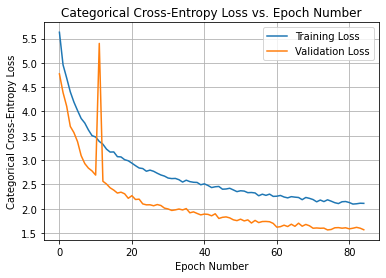

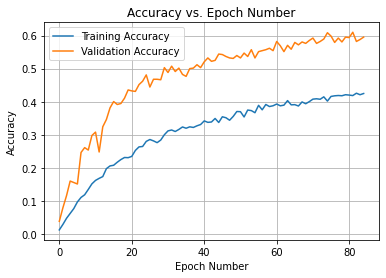

In [ ]:
# Plot the training and validation loss over the training loop
plotHistory(history)
# The loss starts high and soon becomes close to 0
# The validation accuracy is consistently higher than the training accuracy, indicating the the model may be underfitting
# We may want to run for more epochs to get a higher performance
# We note that with this data augmentation technique the training data is different each epoch

In [ ]:
# Show the augmented CNN model's final performance on the training data
acc, f1, p, r, cr = evaluate(CNN_augmented, X_train, Y_train, label_names)
print(f"Accuracy: {acc}")
print(f"F1 Score: {f1}")
print(f"Precision: {p}")
print(f"Recall: {r}")
print(f"Classification Report:\n{cr}")

341/341 [==============================] - 1s 3ms/step
Accuracy: 0.7419354838709677
F1 Score: 0.7334824402608081
Precision: 0.7588265044247459
Recall: 0.7377235918734151
Classification Report:
                  precision    recall  f1-score   support

         Poliwag       0.59      0.65      0.62        37
       Hitmonlee       0.81      0.61      0.70        36
          Tauros       0.91      0.85      0.88        47
          Pidgey       0.73      0.31      0.43        36
      Victreebel       0.94      0.83      0.88        35
         Moltres       0.84      0.70      0.76        37
       Charizard       0.73      0.68      0.70        28
      Electabuzz       0.42      0.87      0.56        31
          Vulpix       0.49      0.88      0.63        41
        Nidoking       0.77      0.90      0.83        40
       Farfetchd       0.93      0.65      0.76        40
          Dodrio       0.91      0.33      0.49        30
        Kabutops       0.75      0.75      0.75     

In [ ]:
# Evaluate the augmented CNN model on the validation data
acc, f1, p, r, cr = evaluate(CNN_augmented, X_val, Y_val, label_names)
print(f"Accuracy: {acc}")
print(f"F1 Score: {f1}")
print(f"Precision: {p}")
print(f"Recall: {r}")
print(f"Classification Report:\n{cr}")

43/43 [==============================] - 0s 4ms/step
Accuracy: 0.6085043988269795
F1 Score: 0.5510826269820077
Precision: 0.5740156695156694
Recall: 0.5897354497354496
Classification Report:
                  precision    recall  f1-score   support

         Poliwag       0.56      0.71      0.63         7
       Hitmonlee       0.50      0.33      0.40         3
          Tauros       0.00      0.00      0.00         3
          Pidgey       0.75      0.50      0.60         6
      Victreebel       1.00      0.20      0.33         5
         Moltres       0.33      0.50      0.40         2
       Charizard       1.00      1.00      1.00         3
      Electabuzz       0.50      0.88      0.64         8
          Vulpix       0.50      0.67      0.57         6
        Nidoking       0.50      0.40      0.44         5
       Farfetchd       0.00      0.00      0.00         2
          Dodrio       0.00      0.00      0.00         2
        Kabutops       0.67      0.50      0.57       

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedM

In [ ]:
# Evaluate the augmented CNN model on the testing data
acc, f1, p, r, cr = evaluate(CNN_augmented, X_test, Y_test, label_names)
print(f"Accuracy: {acc}")
print(f"F1 Score: {f1}")
print(f"Precision: {p}")
print(f"Recall: {r}")
print(f"Classification Report:\n{cr}")

43/43 [==============================] - 0s 4ms/step
Accuracy: 0.5865102639296188
F1 Score: 0.5285348501401133
Precision: 0.5707955747955747
Recall: 0.5708347763347763
Classification Report:
                  precision    recall  f1-score   support

         Poliwag       0.33      0.29      0.31         7
       Hitmonlee       0.83      0.56      0.67         9
          Tauros       0.75      0.75      0.75         4
          Pidgey       1.00      0.17      0.29         6
      Victreebel       0.73      0.89      0.80         9
         Moltres       0.00      0.00      0.00         4
       Charizard       0.33      0.25      0.29         4
      Electabuzz       0.33      1.00      0.50         2
          Vulpix       0.50      0.67      0.57         3
        Nidoking       0.78      1.00      0.88         7
       Farfetchd       1.00      0.33      0.50         6
          Dodrio       1.00      0.29      0.44         7
        Kabutops       0.33      1.00      0.50       

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1580: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, "true nor predicted", "F-score is", len(true_sum))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedM

Ultimately, we show the macro-average F1-score of the small CNN model(533,878 total parameters) and the large ResNet50-based model (23,877,526 total parameters) trained without any data augmentation, and also the small CNN model trained with data augmentation, on the training, validation and testing sets.

| Model | Training | Validation | Testing |
|:---:|:---:|:---:|:---:|
|Small CNN| 0.9876 | 0.5536 | 0.5374
|ResNet50-based| **0.9918** | **0.8560** | **0.8635**
| Small CNN with Data Augmentation | 0.7335 | 0.5511 | 0.5285

With data augmentation, the model sees different training data every epoch, which is based on the original training data but with some rotations and shifts. As a result, we see that the model fits less well to the particulars of the training data, and so the difference between training and validation/testing scores is much smaller than without data augmentation. As a result, although the results are only comparable when run for a smaller number of epochs, we note that we may be able to achieve higher performance if we continue training. Since we are still using the same model architecture as the small CNN, we note that the ResNet50-based model still performs better, despite the increase in diversity of training data.

---
## **Task 2: VAEs/GANs for Pokémon Generation**

In this section, we apply Variational Autoencoders (VAEs) and Generative Adversarial Networks (GANs) for the task of generating new images of Pokémon.
We begin by following the Tensorflow tutorial for using a Convolutional Variational Autoencoder (https://www.tensorflow.org/tutorials/generative/cvae) to apply VAEs for Pokémon generation.

In [ ]:
# Install and import packages for creating animations
!pip install imageio
!pip install git+https://github.com/tensorflow/docs
import glob
import imageio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-0s4szcmh
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-0s4szcmh


In [ ]:
# Convert data to float32 type (required by the models in the tutorial)
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Define a function to normalize an image's values between 0 and 1
def transform_data(data):
  data_new = []
  for item in data:
    image_min = np.min(item)
    image_max = np.max(item)
    data_new.append((item - image_min) / (image_max - image_min))
  return np.asarray(data_new).astype('float32')

In [ ]:
# Transform our training and testing datasets with the above function
X_train = transform_data(X_train)
X_test = transform_data(X_test)

In [ ]:
# Define a convolutional variational autoencoder by the provided tutorial,
# with some small adjustments since the size of our images are (128 x 128 x 3)
# rather than (28 x 28 x 1) as in MNIST. We next define a different encoder-
# decoder architecture as this one produces very poor results in the 
# Pokémon generation problem, given the dataset.
class CVAE_old(tf.keras.Model):
  """Convolutional variational autoencoder."""

  def __init__(self, latent_dim):
    super(CVAE_old, self).__init__()
    self.latent_dim = latent_dim
    self.encoder = tf.keras.Sequential(
        [
            tf.keras.layers.InputLayer(input_shape=(128, 128, 3)),
            tf.keras.layers.Conv2D(
                filters=32, kernel_size=3, strides=(2, 2), activation='relu'),
            tf.keras.layers.Conv2D(
                filters=64, kernel_size=3, strides=(2, 2), activation='relu'),
            tf.keras.layers.Flatten(),
            # No activation
            tf.keras.layers.Dense(latent_dim + latent_dim),
        ]
    )

    self.decoder = tf.keras.Sequential(
        [
            tf.keras.layers.InputLayer(input_shape=(latent_dim,)),
            tf.keras.layers.Dense(units=16*16*32, activation=tf.nn.relu),
            tf.keras.layers.Reshape(target_shape=(16, 16, 32)),
            tf.keras.layers.Conv2DTranspose(
                filters=64, kernel_size=3, strides=2, padding='same',
                activation='relu'),
            tf.keras.layers.Conv2DTranspose(
                filters=32, kernel_size=3, strides=4, padding='same',
                activation='relu'),
            # No activation
            tf.keras.layers.Conv2DTranspose(
                filters=3, kernel_size=3, strides=1, padding='same'),
        ]
    )
    print(self.encoder.summary())
    print(self.decoder.summary())

  @tf.function
  def sample(self, eps=None):
    if eps is None:
      eps = tf.random.normal(shape=(100, self.latent_dim))
    return self.decode(eps, apply_sigmoid=True)

  def encode(self, x):
    mean, logvar = tf.split(self.encoder(x), num_or_size_splits=2, axis=1)
    return mean, logvar

  def reparameterize(self, mean, logvar):
    eps = tf.random.normal(shape=mean.shape)
    return eps * tf.exp(logvar * .5) + mean

  def decode(self, z, apply_sigmoid=False):
    logits = self.decoder(z)
    if apply_sigmoid:
      probs = tf.sigmoid(logits)
      return probs
    return logits

In [ ]:
# Define a bigger convolutional variational autoencoder to perform better
# on the task of Pokémon generation, given the dataset. The encoder has larger
# convolutional layers and dense layers and introduces dropout and batch normalization,
# as well as leaky ReLU activations. The decoder has similar adjustments
class CVAE(tf.keras.Model):
  """Convolutional variational autoencoder."""

  def __init__(self, latent_dim):
    super(CVAE, self).__init__()
    self.latent_dim = latent_dim
    self.encoder = tf.keras.Sequential(
        [
            tf.keras.layers.InputLayer(input_shape=(128, 128, 3)),
         
            tf.keras.layers.Conv2D(
                filters=64, kernel_size=11, strides=(4, 4), activation='relu'),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
         
            tf.keras.layers.Conv2D(
                filters=128, kernel_size=5, strides=(2, 2), activation='relu'),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
         
            tf.keras.layers.Conv2D(
                filters=256, kernel_size=3, strides=(1, 1), activation='relu'),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            tf.keras.layers.Flatten(),
  
            tf.keras.layers.Dropout(0.5),
            tf.keras.layers.Dense(256, activation='relu'),
            tf.keras.layers.Dropout(0.5),
            tf.keras.layers.Dense(128, activation='relu'),
            tf.keras.layers.Dropout(0.5),
            # No activation
            tf.keras.layers.Dense(latent_dim + latent_dim),
        ]
    )

    self.decoder = tf.keras.Sequential(
        [
            tf.keras.layers.InputLayer(input_shape=(latent_dim,)),
         
            tf.keras.layers.Dense(units=8*8*32, activation=tf.nn.relu),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
        

            tf.keras.layers.Reshape(target_shape=(8, 8, 32)),
            tf.keras.layers.Conv2DTranspose(
                filters=256, kernel_size=3, strides=1, padding='same',
                activation='relu'),        
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
        
         
            tf.keras.layers.Conv2DTranspose(
                filters=128, kernel_size=5, strides=2, padding='same',
                activation='relu'),  
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
        
         
            tf.keras.layers.Conv2DTranspose(
                filters=64, kernel_size=11, strides=4, padding='same',
                activation='relu'),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
           
            # No activation
            tf.keras.layers.Conv2DTranspose(
                filters=3, kernel_size=3, strides=2, padding='same'),
        ]
    )
    print(self.encoder.summary())
    print(self.decoder.summary())

  @tf.function
  def sample(self, eps=None):
    if eps is None:
      eps = tf.random.normal(shape=(100, self.latent_dim))
    return self.decode(eps, apply_sigmoid=True)

  def encode(self, x):
    mean, logvar = tf.split(self.encoder(x), num_or_size_splits=2, axis=1)
    return mean, logvar

  def reparameterize(self, mean, logvar):
    eps = tf.random.normal(shape=mean.shape)
    return eps * tf.exp(logvar * .5) + mean

  def decode(self, z, apply_sigmoid=False):
    logits = self.decoder(z)
    if apply_sigmoid:
      probs = tf.sigmoid(logits)
      return probs
    return logits

In [ ]:
# Define loss and training step code from the tutorial
optimizer = tf.keras.optimizers.Adam(1e-4)

def log_normal_pdf(sample, mean, logvar, raxis=1):
  log2pi = tf.math.log(2. * np.pi)
  return tf.reduce_sum(
      -.5 * ((sample - mean) ** 2. * tf.exp(-logvar) + logvar + log2pi),
      axis=raxis)

def compute_loss(model, x):
  mean, logvar = model.encode(x)
  z = model.reparameterize(mean, logvar)
  x_logit = model.decode(z)
  cross_ent = tf.nn.sigmoid_cross_entropy_with_logits(logits=x_logit, labels=x)
  logpx_z = -tf.reduce_sum(cross_ent, axis=[1, 2, 3])
  logpz = log_normal_pdf(z, 0., 0.)
  logqz_x = log_normal_pdf(z, mean, logvar)
  return -tf.reduce_mean(logpx_z + logpz - logqz_x)

@tf.function
def train_step(model, x, optimizer):
  """Executes one training step and returns the loss.

  This function computes the loss and gradients, and uses the latter to
  update the model's parameters.
  """
  with tf.GradientTape() as tape:
    loss = compute_loss(model, x)
  gradients = tape.gradient(loss, model.trainable_variables)
  optimizer.apply_gradients(zip(gradients, model.trainable_variables))

In [ ]:
# Define a function for generating a grid of 16 images from the CVAE given a test sample
from matplotlib import transforms
def generate_and_save_images(model, epoch, test_sample):
  mean, logvar = model.encode(test_sample)
  z = model.reparameterize(mean, logvar)
  predictions = model.sample(z)
  fig = plt.figure(figsize=(8, 8))

  predictions = transform_data(predictions)
  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i + 1)
    plt.imshow(predictions[i])
    plt.axis('off')

  plt.savefig('VAE_image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

In [ ]:
# Define a training loop for the CVAE given the Pokémon image training and testing data
# Creates batches of training and testing data and for each epoch, performs a training step
# with the training batch and computes the loss for the testing batch.
# Each epoch, images are generated by passing a test sample into the CVAE
import math
def train_CVAE(model, optimizer, X_train, epochs, X_test):
  batch_size = 32
  batch_se_train = []
  for i in range(X_train.shape[0]):
    if (i % batch_size == 0):
      batch_se_train.append(i)
  if (X_train.shape[0] % batch_size != 0):
    batch_se_train.append(X_train.shape[0])

  batch_se_test = []
  for i in range(X_test.shape[0]):
    if (i % batch_size == 0):
      batch_se_test.append(i)
  if (X_test.shape[0] % batch_size != 0):
    batch_se_test.append(X_test.shape[0])

  for epoch in range(1, epochs + 1):
    for i in range(len(batch_se_train) - 1):
      x_batch = X_train[batch_se_train[i]:batch_se_train[i+1]]
      train_step(model, x_batch, optimizer)
    loss = tf.keras.metrics.Mean()
    for i in range(len(batch_se_test) - 1):
      #print(X_test.shape, batch_se_test[i], batch_se_test[i+1])
      x_batch = X_test[batch_se_test[i]:batch_se_test[i+1]]
      loss(compute_loss(model, x_batch))
    elbo = -loss.result()
    print('Epoch: {}, Test set ELBO: {}'
          .format(epoch, elbo))
    generate_and_save_images(model, epoch, test_sample)

In [ ]:
# Run for up to 200 epochs
epochs = 200
# We choose a latent space dimension of 10
latent_dim = 10
num_examples_to_generate = 16

random_vector_for_generation = tf.random.normal(
    shape=[num_examples_to_generate, latent_dim])

In [ ]:
# Create and summarize the model
model = CVAE(latent_dim)
# The encoder has 8,490,772 parameters, and the decoder has 1,918,851 parameters

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 30, 30, 64)        23296     
                                                                 
 batch_normalization_28 (Bat  (None, 30, 30, 64)       256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_28 (LeakyReLU)  (None, 30, 30, 64)        0         
                                                                 
 conv2d_13 (Conv2D)          (None, 13, 13, 128)       204928    
                                                                 
 batch_normalization_29 (Bat  (None, 13, 13, 128)      512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_29 (LeakyReLU)  (None, 13, 13, 128)      

In [ ]:
# Define a testing sample as the first 16 images in the test set
test_sample = X_test[0:num_examples_to_generate]

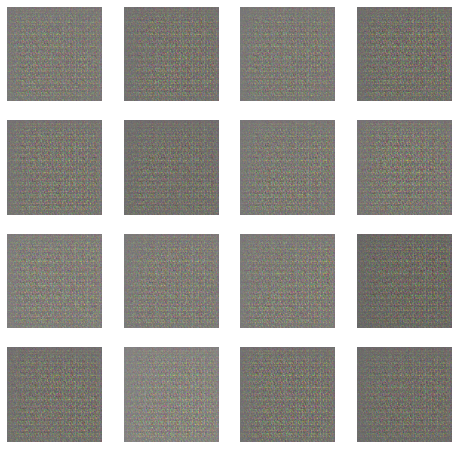

In [ ]:
# Show that with an untrained CVAE, the generated images are just noise
generate_and_save_images(model, 0, test_sample)

In [ ]:
# Train the CVAE and show progress by showing generated images at each epoch
# Having so many images makes this notebook too large for GitHub, so
# we hide the output here... A GIF showing the epoch progress is shown below
# We cut the training off after 61 epochs due to time constraints in Google Colab
# We see that the CVAE does make some progress, and perhaps with a better architecture
# or more epochs we will get better looking Pokémon.
# We discuss the limitations of our current implementation later...
train_CVAE(model, optimizer, X_train, epochs, X_test)

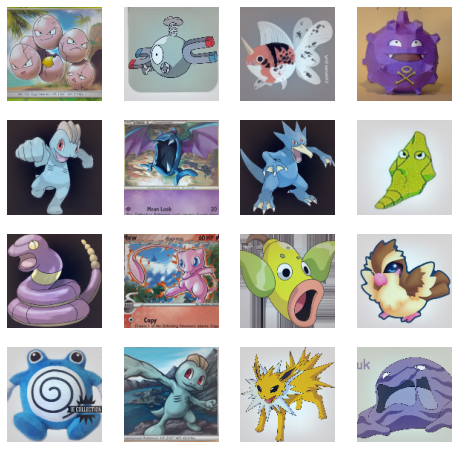

In [ ]:
# Plot the test sample as a comparison to the generated images
# We see that in general the shapes and colors of the generated images
# are somewhat correct
fig = plt.figure(figsize=(8, 8))
for i in range(test_sample.shape[0]):
    plt.subplot(4, 4, i + 1)
    image_min = np.min(test_sample[i])
    image_max = np.max(test_sample[i])
    image = (test_sample[i] - image_min) / (image_max - image_min)
    plt.imshow(image)
    plt.axis('off')
plt.show()

In [ ]:
# Create a size-16 sample of training data
train_sample = X_train[0:num_examples_to_generate]

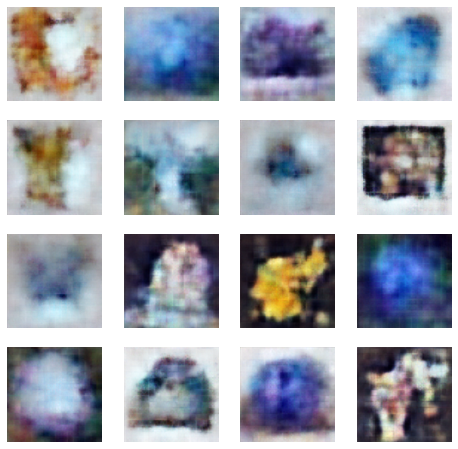

In [ ]:
# Pass the training sample through the CVAE and show generated images
mean, logvar = model.encode(train_sample)
z = model.reparameterize(mean, logvar)
predictions = model.sample(z)
predictions = transform_data(predictions)

fig = plt.figure(figsize=(8, 8))

for i in range(predictions.shape[0]):
  plt.subplot(4, 4, i + 1)
  plt.imshow(predictions[i])
  plt.axis('off')

plt.show()

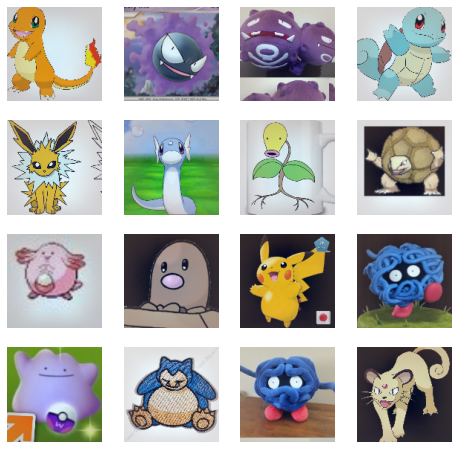

In [ ]:
# Plot the training sample as a comparison to the generated images
# We see, again, that in general the shapes and colors of the generated images
# are somewhat correct
fig = plt.figure(figsize=(8, 8))
for i in range(train_sample.shape[0]):
    plt.subplot(4, 4, i + 1)
    image_min = np.min(train_sample[i])
    image_max = np.max(train_sample[i])
    image = (train_sample[i] - image_min) / (image_max - image_min)
    plt.imshow(image)
    plt.axis('off')
plt.show()

In [ ]:
# Create a GIF for showing the progress of the CVAE during training
anim_file = 'cvae.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('VAE_image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


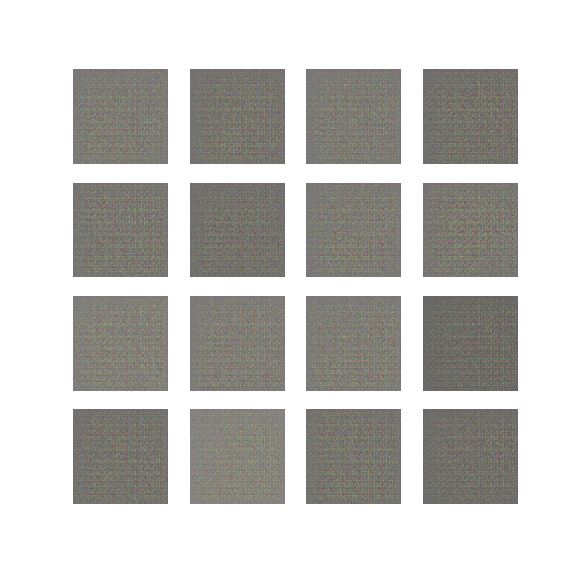

In [ ]:
# Show the GIF
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

Lastly, we follow the Tensorflow tutorial for using a Deep Convolutional Generative Adversarial Network (https://www.tensorflow.org/tutorials/generative/dcgan) to apply GANs for Pokémon generation.

In [ ]:
# Import for convenience
!pip install keras
from keras import layers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# Define the generator model, extended from the one provided in the tutorial to
# produce images of size (128 x 128 x 3) rather than (28 x 28 x 1) and using larger layers
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((8, 8, 256)))
    assert model.output_shape == (None, 8, 8, 256)  # Note: None is the batch size

    model.add(layers.Conv2DTranspose(384, (3, 3), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(256, (3, 3), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(3, (11, 11), strides=(4, 4), padding='same', use_bias=False, activation='tanh'))

    return model

In [ ]:
# Summarize the generator model
generator = make_generator_model()
generator.summary()
# The model has 3,909,056 parameters

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_23 (Dense)            (None, 16384)             1638400   
                                                                 
 batch_normalization_47 (Bat  (None, 16384)            65536     
 chNormalization)                                                
                                                                 
 leaky_re_lu_47 (LeakyReLU)  (None, 16384)             0         
                                                                 
 reshape_8 (Reshape)         (None, 8, 8, 256)         0         
                                                                 
 conv2d_transpose_32 (Conv2D  (None, 8, 8, 384)        884736    
 Transpose)                                                      
                                                                 
 batch_normalization_48 (Bat  (None, 8, 8, 384)      

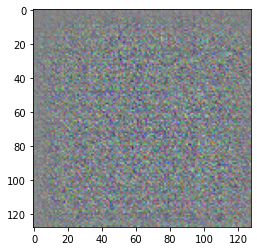

In [ ]:
# Show that before training, and given noise, the generator model generates noise
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)
generated_image = transform_data(generated_image)

plt.imshow(generated_image[0, :, :, :])

In [ ]:
# Define the discriminator model, extended from the one provided in the tutorial to
# take in images of size (128 x 128 x 3) rather than (28 x 28 x 1) and using larger layers
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (11, 11), strides=(4, 4), padding='same',
                                     input_shape=[128, 128, 3]))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    #model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    #model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(256, (3, 3), strides=(1, 1), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Flatten())

    model.add(layers.Dropout(0.5))
    model.add(layers.Dense(128, activation='relu'))
    model.add(layers.Dropout(0.5))
    model.add(layers.Dense(1))

    return model

In [ ]:
# Summarize the discriminator model
discriminator = make_discriminator_model()
discriminator.summary()
# The model has 8,914,049 parameters

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 32, 32, 64)        23296     
                                                                 
 batch_normalization_51 (Bat  (None, 32, 32, 64)       256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_51 (LeakyReLU)  (None, 32, 32, 64)        0         
                                                                 
 conv2d_16 (Conv2D)          (None, 16, 16, 128)       204928    
                                                                 
 batch_normalization_52 (Bat  (None, 16, 16, 128)      512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_52 (LeakyReLU)  (None, 16, 16, 128)     

In [ ]:
# Show that the untrained discriminator model does not produce any meaningful output
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-0.00682913]], shape=(1, 1), dtype=float32)


In [ ]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
# Define the discriminator loss
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [ ]:
# Define the generator loss
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [ ]:
# Create Adam optimizers for both models 
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [ ]:
# We will run up to 200 epochs of training with an input dimension of 100 to the generator
epochs = 200
noise_dim = 100
num_examples_to_generate = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [ ]:
# Define a training step. First, the generator generates images from random noise.
# Next, the discriminator tries to classify real images as real and generated images
# as fake. Then, the losses are computed and the gradients are backpropagated.
@tf.function
def train_step(images):
    noise = tf.random.normal([64, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [ ]:
# Define a function to generate images given a test input
def generate_and_save_images(model, epoch, test_input):
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(8, 8))

  predictions = transform_data(predictions)
  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      plt.imshow(predictions[i, :, :, :])
      plt.axis('off')

  plt.savefig('GAN_image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

In [ ]:
# Run the training of the GAN on a training dataset for a given number of epochs
def train(dataset, epochs):

  batch_size = 32
  batch_se_train = []
  for i in range(X_train.shape[0]):
    if (i % batch_size == 0):
      batch_se_train.append(i)
  if (X_train.shape[0] % batch_size != 0):
    batch_se_train.append(X_train.shape[0])

  for epoch in range(epochs):
    print(f"Epoch {epoch}:")
    for i in range(len(batch_se_train) - 1):
      data_batch = dataset[batch_se_train[i]:batch_se_train[i+1]]
      train_step(data_batch)

    generate_and_save_images(generator,
                             epoch + 1,
                             seed)

  generate_and_save_images(generator,
                           epochs,
                           seed)

In [ ]:
# Train the GAN and show progress by showing generated images at each epoch
# Having so many images makes this notebook too large for GitHub, so
# we hide the output here... A GIF showing the epoch progress is shown below
# We cut the training off after 112 epochs due to time constraints in Google Colab
# We see that the GAN that we have defined makes little progress, and perhaps with a better architecture
# or more epochs we will get better looking Pokémon.
# We discuss the limitations of our current implementation later...
train(X_train, epochs)

In [ ]:
# Create a GIF for showing the progress of the GAN during training
anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('GAN_image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


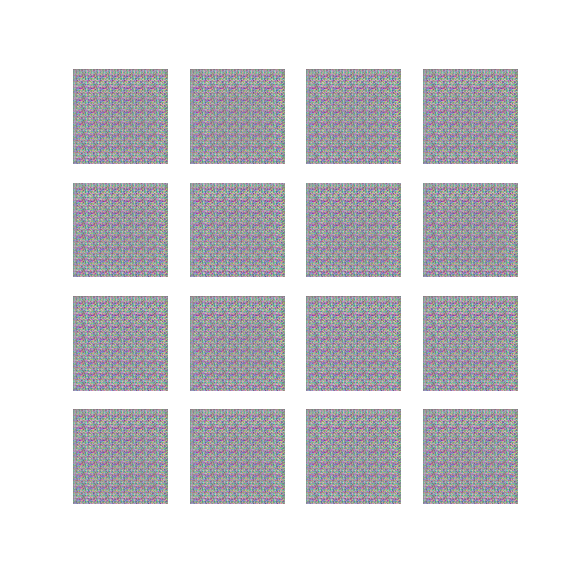

In [ ]:
# Show the GIF
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

**Conclusions**: Ultimately, with our implementations of the CVAE and GAN for Pokémon generation, we see that the CVAE starts to converge toward producing reasonable Pokémon images, whereas the GAN does not seem to make too much progress. First, we note that this is partially a result of the data that we have for Pokémon generation. Compared to MNIST, which has many (60,000) small (28 x 28 x 1) grayscale images that belong only to one of ten classes each, the Pokémon images dataset has only few (6,820) larger (128 x 128 x 3) color images that belong to one of 150 classes each. The data is far more complicated and fewer, and, as there are 150 classes, the data are generally very different images. As a result, training an encoder-decoder architecture, such as CVAE, to generate images is more complicated, and training a GAN is similarly more complicated. Next, we note that our current implementations of the models and training for both the CVAE and GAN could be limited for this task. Based on our experimentation with relatively small CNNs for our models, we find that the results for image generation are not particularly strong. In order to improve upon the results shown here, there are a few ways we can experiment with:
- Data augmentation: The data we have is small; data augmentation can improve the size and diversity of the dataset
- Using more complex network architectures or use newer architectural innovations such as residual blocks
- Running for more training epochs
- Varying hyperparameters such as learning rate, batch size, latent space dimensionality, etc... 